In [1]:
from matplotlib import pyplot as plt
import numpy as np 
import pandas as pd
import keras
import keras.backend as Kback
from keras import layers
from keras.models import Sequential, load_model
from keras.layers import Dense, Dropout, LSTM, SimpleRNN
from keras.layers.core import Activation
from keras.callbacks import ModelCheckpoint

from sklearn.preprocessing import StandardScaler
from sklearn.decomposition import PCA
from sklearn.cluster import KMeans

model_path = 'RNN_regression_PCA_FD4.h5'

import random
random.seed(123)


Using TensorFlow backend.


In [2]:
from math import e

In [3]:
#######
#Data ingestion & processing
######

train_df = pd.read_csv("C:/Users/eduardo.tadeo/OneDrive - INVENSITY GmbH/Master Thesis/Master Thesis/Datasets/CMAPSSData/train_FD004.txt", delimiter = ' ')
test_df  = pd.read_csv("C:/Users/eduardo.tadeo/OneDrive - INVENSITY GmbH/Master Thesis/Master Thesis/Datasets/CMAPSSData/test_FD004.txt", delimiter = ' ')
RUL_test = pd.read_csv("C:/Users/eduardo.tadeo/OneDrive - INVENSITY GmbH/Master Thesis/Master Thesis/Datasets/CMAPSSData/RUL_FD004.txt")
RUL_real = RUL_test

#Unuseful columns deleting 

train_df.drop(['T_EGT', 'SmFan', 'SmLPC', 'SmHPC'], axis = 1, inplace = True)

test_df.drop(['T_EGT', 'SmFan', 'SmLPC', 'SmHPC'], axis = 1, inplace = True)


#We need to identify every operating mode and normalize it 

kmeans = KMeans(n_clusters = 6, random_state = 0).fit(train_df[['OP1','OP2','OP3']])
train_df['OP_Condition'] = kmeans.labels_

test_df['OP_Condition'] = kmeans.predict(test_df[['OP1','OP2','OP3']])

###TRAIN DATA SET###

# Standarization for both sensor variables and operational conditions

train_df['Cycle_norm'] = train_df['Cycle']
cols_normalize = train_df.columns.difference(['Unit','Cycle','UL','RUL','UL_30','UL_50', 'UL_75'])

scaler0 = StandardScaler()
train_df.loc[train_df['OP_Condition']==0, cols_normalize] = scaler0.fit_transform(train_df.loc[train_df['OP_Condition']==0, cols_normalize])

scaler1 = StandardScaler()
train_df.loc[train_df['OP_Condition']==1, cols_normalize] = scaler1.fit_transform(train_df.loc[train_df['OP_Condition']==1, cols_normalize])

scaler2 = StandardScaler()
train_df.loc[train_df['OP_Condition']==2, cols_normalize] = scaler2.fit_transform(train_df.loc[train_df['OP_Condition']==2, cols_normalize])

scaler3 = StandardScaler()
train_df.loc[train_df['OP_Condition']==3, cols_normalize] = scaler3.fit_transform(train_df.loc[train_df['OP_Condition']==3, cols_normalize])

scaler4 = StandardScaler()
train_df.loc[train_df['OP_Condition']==4, cols_normalize] = scaler4.fit_transform(train_df.loc[train_df['OP_Condition']==4, cols_normalize])

scaler5 = StandardScaler()
train_df.loc[train_df['OP_Condition']==5, cols_normalize] = scaler5.fit_transform(train_df.loc[train_df['OP_Condition']==5, cols_normalize])

train_normalized = train_df

scaled_train = train_df[cols_normalize]

# Principal Component Analysis Dimensionality Reduction

pca = PCA(.95)

pca.fit(scaled_train)
transformed_train = pca.transform(scaled_train)

df_transformed_train = pd.DataFrame(transformed_train, index = train_df.index)

join_df = train_df[train_df.columns.difference(cols_normalize)].join(df_transformed_train)
train_df = join_df.reindex()


# Data labeling - Remaining Useful LIfe (RUL) --> Time to failure

RUL = pd.DataFrame(train_df.groupby('Unit')['Cycle'].max()).reset_index()
RUL.columns = ['Unit','UL']
train_df = train_df.merge(RUL, on = ['Unit'], how = 'left')
train_df['RUL'] = train_df['UL'] - train_df['Cycle']


# Data labeling - UL_30 - UL_50 - UL_75 --> Labeling to predict if the turbine is going to fail on les than 30, 50 or 75 cycles

train_df['UL_30'] = np.where(train_df['RUL'] <= 30, 1, 0)
train_df['UL_50'] = np.where(train_df['RUL'] <= 50, 1, 0)
train_df['UL_75'] = np.where(train_df['RUL'] <= 75, 1, 0)




In [4]:
def complete (test_df, seq_length):

    for i in test_df['Unit']:

        test = test_df[test_df['Unit']==i]

        if (test['Cycle'].max()<seq_length):

            print("He entrado en ", i)

            n_cycles = seq_length - test['Cycle'].max()

            new_values = np.zeros((n_cycles.astype(int),test_df.shape[1]))
            new_values[:,2:] = test.iloc[:,2:].mean(axis = 0).to_numpy()
            new_values[:,0] = i
            new_values[:,1] = range(test['Cycle'].max().astype(int)+1, seq_length+1)

            new_values = pd.DataFrame(new_values, columns = test_df.columns)

            test = pd.concat([test,new_values]).reset_index()

            test = test.drop(test.columns[0],axis=1)

            #print(test.head())

            test_df = pd.concat([test_df[test_df['Unit']<i],test,test_df[test_df['Unit']>i]]).reset_index()

            test_df = test_df.drop(test_df.columns[0],axis = 1)


    return test_df


In [5]:
sequence_length = 50

test_df = complete(test_df, sequence_length+1)


He entrado en  10
He entrado en  19
He entrado en  28
He entrado en  46
He entrado en  59
He entrado en  76
He entrado en  125
He entrado en  141
He entrado en  144
He entrado en  156
He entrado en  164
He entrado en  169
He entrado en  170
He entrado en  186
He entrado en  204
He entrado en  225
He entrado en  229
He entrado en  239
He entrado en  241
He entrado en  246


In [6]:
###TEST DATA SET###


#Normalize data
test_df['Cycle_norm'] = test_df['Cycle']
test_df['Cycle_norm'] = test_df['Cycle']

test_df.loc[test_df['OP_Condition']==0, cols_normalize] = scaler0.fit_transform(test_df.loc[test_df['OP_Condition']==0, cols_normalize])

test_df.loc[test_df['OP_Condition']==1, cols_normalize] = scaler1.fit_transform(test_df.loc[test_df['OP_Condition']==1, cols_normalize])

test_df.loc[test_df['OP_Condition']==2, cols_normalize] = scaler2.fit_transform(test_df.loc[test_df['OP_Condition']==2, cols_normalize])

test_df.loc[test_df['OP_Condition']==3, cols_normalize] = scaler3.fit_transform(test_df.loc[test_df['OP_Condition']==3, cols_normalize])

test_df.loc[test_df['OP_Condition']==4, cols_normalize] = scaler4.fit_transform(test_df.loc[test_df['OP_Condition']==4, cols_normalize])

test_df.loc[test_df['OP_Condition']==5, cols_normalize] = scaler5.fit_transform(test_df.loc[test_df['OP_Condition']==5, cols_normalize])

norm_test_df = test_df[cols_normalize]

#Principal Component Analysis Dimensionality Reduction

transformed_test = pca.transform(norm_test_df)

df_transformed_test = pd.DataFrame(transformed_test, index = test_df.index)

join_df = test_df[test_df.columns.difference(cols_normalize)].join(df_transformed_test)
test_df = join_df.reindex()

# We use the ground truth dataset to generate labels for the test data.
# generate column max for test data
rul = pd.DataFrame(test_df.groupby('Unit')['Cycle'].max()).reset_index()
rul.columns = ['Unit', 'max']
RUL_test.columns = ['more']
RUL_test['Unit'] = RUL_test.index + 1
RUL_test['max'] = rul['max'] + RUL_test['more']
RUL_test.drop('more', axis=1, inplace=True)

# generate RUL for test data
test_df = test_df.merge(RUL_test, on=['Unit'], how='left')
test_df['RUL'] = test_df['max'] - test_df['Cycle']
#test_df.drop('max', axis=1, inplace=True)

#Data labeling - UL_30 - UL_50 - UL_75 --> Labeling to predict if the turbine is going to fail on les than 30, 50 or 75 cycles

test_df['UL_30'] = np.where(test_df['RUL'] <= 30, 1, 0)
test_df['UL_50'] = np.where(test_df['RUL'] <= 50, 1, 0)
test_df['UL_75'] = np.where(test_df['RUL'] <= 75, 1, 0)






In [ ]:
test_df.head()

In [ ]:
train_df.iloc[:,2:-5].head()

In [7]:
#####
#Data formatting#
####

# Data will be input into the RNN in windows with a certain size
sequence_length = 50

# function to reshape features into (samples, time steps, features) 
def gen_sequence(id_df, seq_length, seq_cols):
    """ Only sequences that meet the window-length are considered, no padding is used. This means for testing
    we need to drop those which are below the window-length. An alternative would be to pad sequences so that
    we can use shorter ones """
    # for one id I put all the rows in a single matrix
    data_matrix = id_df[seq_cols].values
    num_elements = data_matrix.shape[0]
    # Iterate over two lists in parallel.
    # For example id1 have 192 rows and sequence_length is equal to 50
    # so zip iterate over two following list of numbers (0,112),(50,192)
    # 0 50 -> from row 0 to row 50
    # 1 51 -> from row 1 to row 51
    # 2 52 -> from row 2 to row 52
    # ...
    # 111 191 -> from row 111 to 191
    for start, stop in zip(range(0, num_elements-seq_length), range(seq_length, num_elements)):
        yield data_matrix[start:stop, :]

sequence_cols = list(train_df.columns[2:-5].values)
#sequence_cols.extend(["Cycle_norm"])

#val=list(gen_sequence(train_df[train_df['Unit']==1], sequence_length, sequence_cols))

seq_gen = (list(gen_sequence(train_df[train_df['Unit']==id], sequence_length, sequence_cols)) 
           for id in train_df['Unit'].unique())


# generate sequences and convert to numpy array
seq_array = np.concatenate(list(seq_gen)).astype(np.float32)
print(seq_array.shape)

def gen_labels(id_df, seq_length, label):
    """ Only sequences that meet the window-length are considered, no padding is used. This means for testing
    we need to drop those which are below the window-length. An alternative would be to pad sequences so that
    we can use shorter ones """
    # For one id I put all the labels in a single matrix.
    # For example:
    # [[1]
    # [4]
    # [1]
    # [5]
    # [9]
    # ...
    # [200]] 
    data_matrix = id_df[label].values
    num_elements = data_matrix.shape[0]
    # I have to remove the first seq_length labels
    # because for one id the first sequence of seq_length size have as target
    # the last label (the previus ones are discarded).
    # All the next id's sequences will have associated step by step one label as target.
    return data_matrix[seq_length:num_elements, :]

# generate labels
label_gen = [gen_labels(train_df[train_df['Unit']==id], sequence_length, ['RUL']) 
             for id in train_df['Unit'].unique()]

label_array = np.concatenate(label_gen).astype(np.float32)
label_array.shape


(48799, 50, 15)


(48799, 1)

In [ ]:
label_array[label_array >150] = 150

In [8]:
def r2_keras(y_true, y_pred):
    ##Coefficient of Determination##

    SS_res = Kback.sum(Kback.square(y_true - y_pred))
    SS_tot = Kback.sum(Kback.square( y_true - Kback.mean(y_true)))
    return (1 - SS_res/(SS_tot + Kback.epsilon()))

def Computed_Score(y_true, y_pred):
    ##Computed score used in the challenge

    a1 = 10
    a2 = 13
    score = 0
    d = y_pred - y_true

    score_vec = np.zeros(len(y_true))

    for i in range(len(d)): 
        if d[i]<0:
            score_vec[i] = (e**(-d[i]/a1) - 1)
            score += score_vec[i]
        else : 
            score_vec[i] = (e**(d[i]/a2) - 1)
            score += score_vec[i]

    fig_hist = plt.figure(figsize=(10,5))
    plt.hist(score_vec, color = "#3f729a" )
    hist_data, _, _ = plt.hist(score_vec, color = "#3f729a" )
    print(hist_data)
    plt.ylabel("Frequency")
    plt.xlabel("Score")

    score_low = 0
    score_high = 0

    for i in range(len(d)):

        if score_vec[i] < 50:
            score_low += score_vec[i]
        else:
            score_high += score_vec[i]

    

    print(score_low, score_high)
    print(score_low/(score_low + score_high))

    plt.figure()
    plt.plot(range(len(y_true)),score_vec)

    return score



In [9]:
nb_features = seq_array.shape[2]
nb_out = label_array.shape[1]

RNN_model = Sequential()
RNN_model.add(LSTM(
    input_shape = (sequence_length, nb_features),
    units = 50,
    return_sequences = True))
RNN_model.add(Dropout(0.2))
RNN_model.add(LSTM(units = 25, return_sequences = True))
RNN_model.add(Dropout(0.2))
RNN_model.add(LSTM(units = 25, return_sequences = False))
RNN_model.add(Dropout(0.2))
RNN_model.add(Dense(units = nb_out))
RNN_model.add(Activation("linear"))
RNN_model.compile(loss = 'mean_squared_error', optimizer = 'rmsprop', metrics = ['mae', r2_keras])

print(RNN_model.summary())

result = RNN_model.fit(seq_array, label_array, epochs = 100, batch_size = 100, validation_split = 0.05, verbose = 1,
    callbacks = [keras.callbacks.EarlyStopping(monitor = 'val_loss', min_delta = 0, patience=10, verbose = 0, mode = 'min'), 
        keras.callbacks.ModelCheckpoint(model_path, monitor = 'val_loss', save_best_only = True, mode = 'min', verbose = 0)]
    )
print(result.history.keys())

Model: "sequential_1"
_________________________________________________________________
Layer (type)                 Output Shape              Param #   
lstm_1 (LSTM)                (None, 50, 50)            13200     
_________________________________________________________________
dropout_1 (Dropout)          (None, 50, 50)            0         
_________________________________________________________________
lstm_2 (LSTM)                (None, 50, 25)            7600      
_________________________________________________________________
dropout_2 (Dropout)          (None, 50, 25)            0         
_________________________________________________________________
lstm_3 (LSTM)                (None, 25)                5100      
_________________________________________________________________
dropout_3 (Dropout)          (None, 25)                0         
_________________________________________________________________
dense_1 (Dense)              (None, 1)                

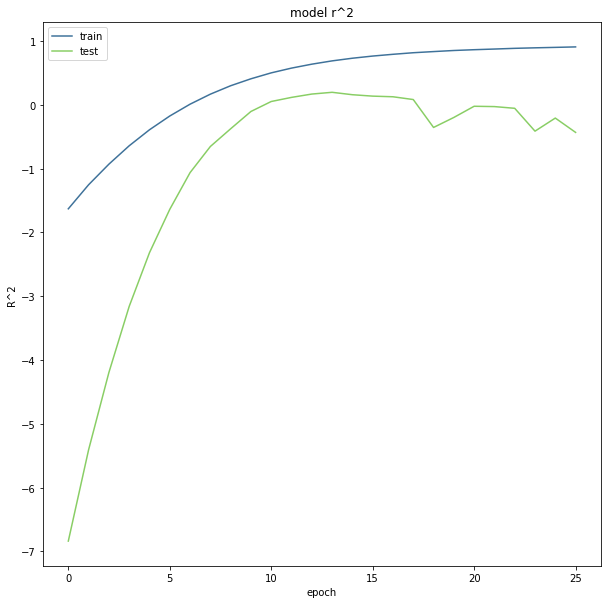

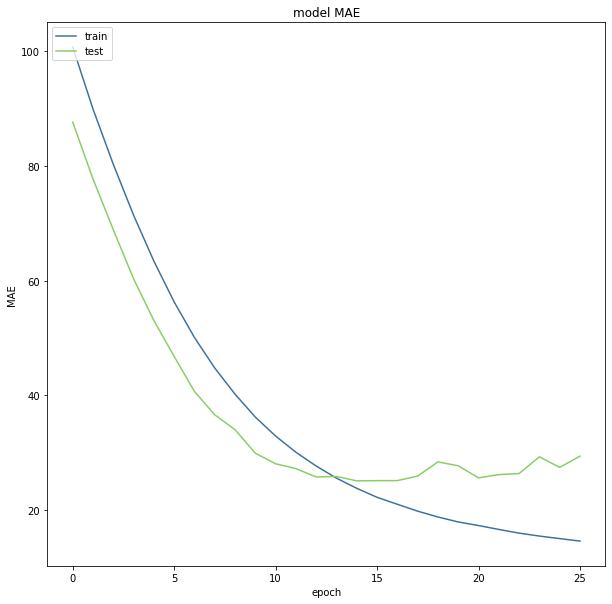

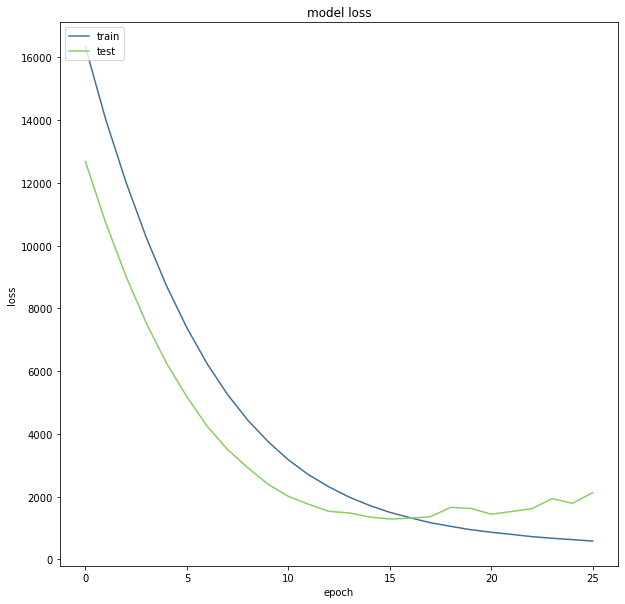

In [10]:
# summarize history for R^2
fig_acc = plt.figure(figsize=(10, 10))
plt.plot(result.history['r2_keras'], color="#3f729a")
plt.plot(result.history['val_r2_keras'], color="#89ce65")
plt.title('model r^2')
plt.ylabel('R^2')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
#fig_acc.savefig("model_r2.png")

# summarize history for MAE
fig_acc = plt.figure(figsize=(10, 10))
plt.plot(result.history['mae'], color="#3f729a")
plt.plot(result.history['val_mae'], color="#89ce65")
plt.title('model MAE')
plt.ylabel('MAE')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
#fig_acc.savefig("model_mae.png")

# summarize history for Loss
fig_acc = plt.figure(figsize=(10, 10))
plt.plot(result.history['loss'], color="#3f729a")
plt.plot(result.history['val_loss'], color="#89ce65")
plt.title('model loss')
plt.ylabel('loss')
plt.xlabel('epoch')
plt.legend(['train', 'test'], loc='upper left')
plt.show()
#fig_acc.savefig("model_regression_loss.png")


In [11]:
# training metrics
scores = RNN_model.evaluate(seq_array, label_array, verbose=1, batch_size=200)
print('\nMAE: {}'.format(scores[1]))
print('\nR^2: {}'.format(scores[2]))

y_pred = RNN_model.predict(seq_array,verbose=1, batch_size=200)
y_true = label_array

#test_set = pd.DataFrame(y_pred)
#test_set.to_csv('submit_train.csv', index = None)

48799/48799 [==============================] - 19s 387us/step

MAE: 12.192026138305664

R^2: 0.8799514770507812
48799/48799 [==============================] - 19s 380us/step



MAE: 33.69648361206055

R^2: 0.12677732110023499


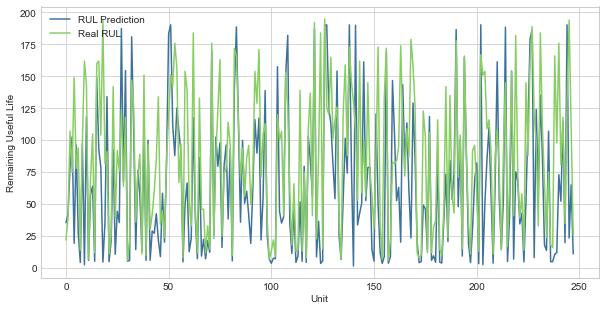

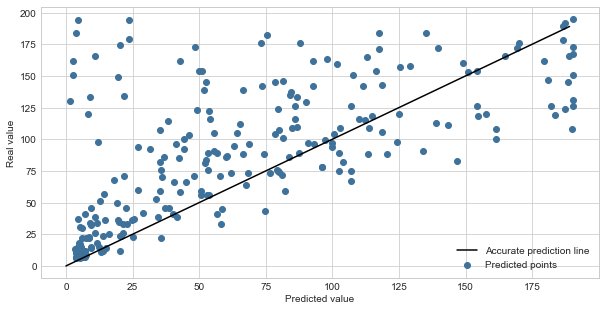

In [12]:
# We pick the last sequence for each id in the test data
seq_array_test_last = [test_df[test_df['Unit']==id][sequence_cols].values[-sequence_length:] 
                       for id in test_df['Unit'].unique() if len(test_df[test_df['Unit']==id]) >= sequence_length]

seq_array_test_last = np.asarray(seq_array_test_last).astype(np.float32)
#print("seq_array_test_last")
#print(seq_array_test_last)
#print(seq_array_test_last.shape)

# Similarly, we pick the labels
#print("y_mask")
y_mask = [len(test_df[test_df['Unit']==id]) >= sequence_length for id in test_df['Unit'].unique()]
label_array_test_last = test_df.groupby('Unit')['RUL'].nth(-1)[y_mask].values
label_array_test_last = label_array_test_last.reshape(label_array_test_last.shape[0],1).astype(np.float32)
#print(label_array_test_last.shape)
#print("label_array_test_last")
#print(label_array_test_last)

# if best iteration's model was saved then load and use it
if os.path.isfile(model_path):
    
    estimator = load_model(model_path,custom_objects={'r2_keras': r2_keras})

    # test metrics
    scores_test = estimator.evaluate(seq_array_test_last, label_array_test_last, verbose=2)
    print('\nMAE: {}'.format(scores_test[1]))
    print('\nR^2: {}'.format(scores_test[2]))

    y_pred_test = estimator.predict(seq_array_test_last)
    y_true_test = label_array_test_last

    test_set = pd.DataFrame(y_pred_test)
    test_set.to_csv('submit_test.csv', index = None)

    plt.style.use('seaborn-whitegrid')

    # Plot in blue color the predicted data and in green color the
    # actual data to verify visually the accuracy of the model.
    fig_verify = plt.figure(figsize=(10, 5))
    plt.plot(y_pred_test, color="#3f729a")
    plt.plot(y_true_test, color="#89ce65")
    plt.ylabel('Remaining Useful Life')
    plt.xlabel('Unit')
    plt.legend(['RUL Prediction', 'Real RUL'], loc='best')
    plt.show()
    fig_verify.savefig("model_regression_verify.png")

    #Plot the results

    fig_predict = plt.figure(figsize = (10,5))
    plt.scatter(y_pred_test, y_true_test, color = "#3f729a")
    plt.plot(range(y_pred_test.max().astype(int)),range(y_pred_test.max().astype(int)), color = "black")
    plt.ylabel('Real value')
    plt.xlabel('Predicted value')
    plt.legend(['Accurate prediction line', 'Predicted points'])
    plt.show()

[245.   1.   0.   0.   1.   0.   0.   0.   0.   1.]
1179.9148248434067 289390206.1125488
4.077228562469368e-06
The computed challenge score is: S = 289391386.0273737


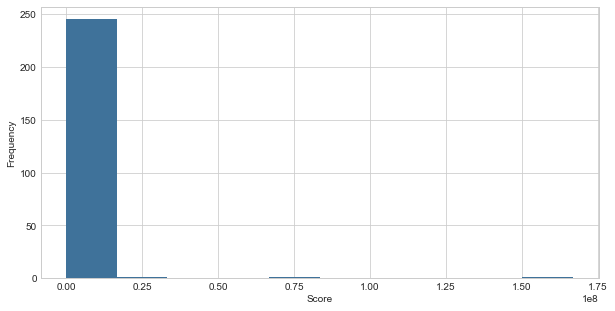

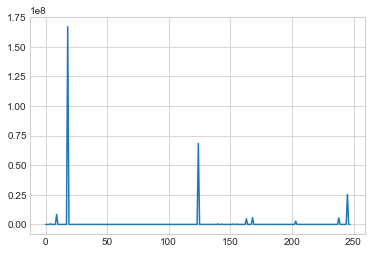

In [13]:
print("The computed challenge score is: S = {}".format(Computed_Score(y_true_test, y_pred_test)))

The model score is: 289391546.703938
The model accuracy is: 36.29032258064516
The model MAE is: 33.69648742675781
The model MSE is : 2504.5027721774195
The model Mean Absolute Percentage Error (MAPE) is: 224.33865454889113
The model Mean Absolute Percentage Error 2 (MAPE_2) is: 3312.2443600651186


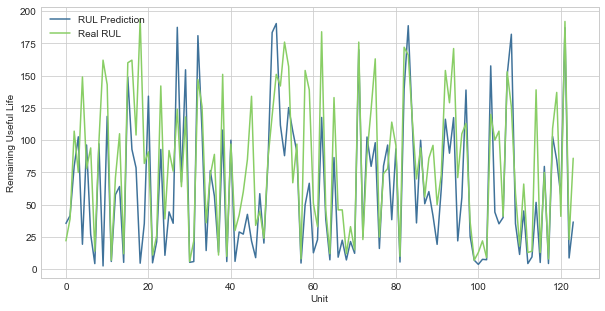

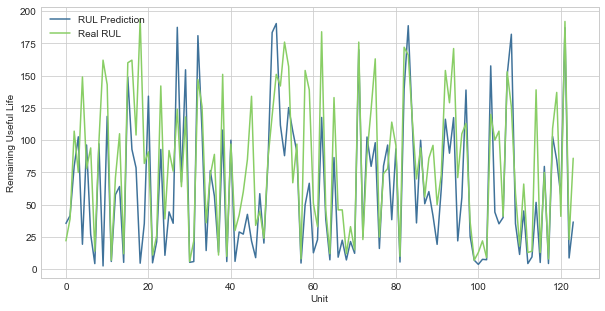

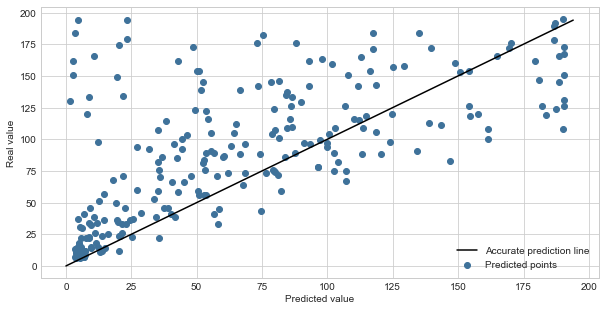

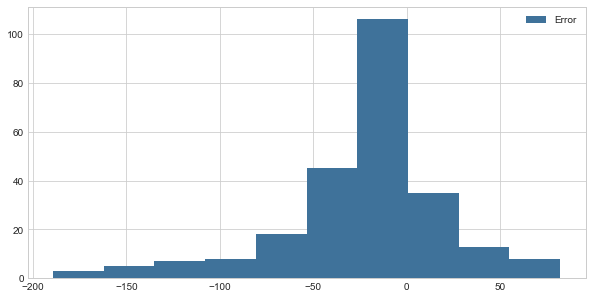

In [14]:
from Perform_function import perform_func 
_, _, _, _, _, _ = perform_func(y_pred_test, y_true_test, test_df.groupby('Unit').max()['Cycle'].to_numpy())

In [15]:
train_predictions = RNN_model.predict(seq_array)
train_predictions.shape

(48799, 1)

In [16]:
train_df['RUL_predict'] = 0
indice_retransf = 0
for i in train_df['Unit'].unique():

    print(i)

    max_indice = train_df.loc[train_df['Unit']==i,'Cycle'].max() + indice_retransf -50

    print()

    print(train_df.loc[(train_df['Unit']==i)&(train_df['Cycle']>50), 'RUL_predict'].shape)
    print(train_predictions[indice_retransf:max_indice,0].shape)


    train_df.loc[(train_df['Unit']==i)&(train_df['Cycle']>50), 'RUL_predict'] = train_predictions[indice_retransf:max_indice,0]

    indice_retransf += train_df.loc[train_df['Unit']==i,'Cycle'].max() - 50

1

(271,)
(271,)
2

(249,)
(249,)
3

(257,)
(257,)
4

(224,)
(224,)
5

(143,)
(143,)
6

(281,)
(281,)
7

(171,)
(171,)
8

(180,)
(180,)
9

(284,)
(284,)
10

(304,)
(304,)
11

(251,)
(251,)
12

(222,)
(222,)
13

(206,)
(206,)
14

(203,)
(203,)
15

(174,)
(174,)
16

(134,)
(134,)
17

(101,)
(101,)
18

(293,)
(293,)
19

(160,)
(160,)
20

(195,)
(195,)
21

(177,)
(177,)
22

(161,)
(161,)
23

(230,)
(230,)
24

(136,)
(136,)
25

(100,)
(100,)
26

(247,)
(247,)
27

(113,)
(113,)
28

(152,)
(152,)
29

(197,)
(197,)
30

(247,)
(247,)
31

(213,)
(213,)
32

(169,)
(169,)
33

(151,)
(151,)
34

(226,)
(226,)
35

(171,)
(171,)
36

(93,)
(93,)
37

(338,)
(338,)
38

(127,)
(127,)
39

(152,)
(152,)
40

(156,)
(156,)
41

(229,)
(229,)
42

(230,)
(230,)
43

(173,)
(173,)
44

(153,)
(153,)
45

(127,)
(127,)
46

(271,)
(271,)
47

(325,)
(325,)
48

(272,)
(272,)
49

(396,)
(396,)
50

(122,)
(122,)
51

(235,)
(235,)
52

(307,)
(307,)
53

(254,)
(254,)
54

(147,)
(147,)
55

(294,)
(294,)
56

(297,)
(297,)
57


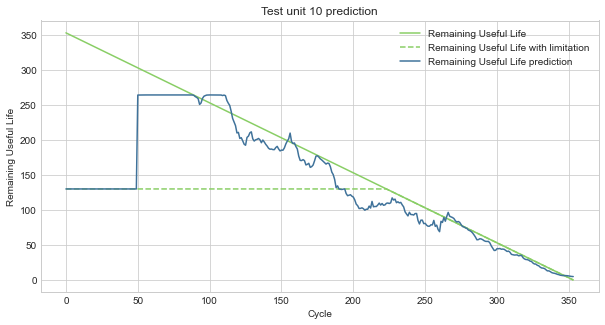

In [17]:
unit = 10

train_df['RUL_tuned']=train_df['RUL']
train_df.loc[train_df['RUL']>130,'RUL_tuned'] = 130
train_df.loc[train_df['Cycle']<=50,'RUL_predict'] = 130


plt.style.use('seaborn-whitegrid')
fig = plt.figure(figsize = (10,5))

ax = fig.add_subplot(111)
ax.plot(range(len(train_df[train_df['Unit']==unit])), train_df[train_df['Unit']==unit]['RUL'], color = "#89ce65", label = "Remaining Useful Life")

ax.plot(range(len(train_df[train_df['Unit']==unit])), train_df[train_df['Unit']==unit]['RUL_tuned'], color = "#89ce65", label = "Remaining Useful Life with limitation", linestyle = '--')
#ax.plot(range(len(train_df[train_df['Unit']==unit + v])), train_df[train_df['Unit']==unit+v]['RUL'], color = "#89ce65", label = "Remaining Useful Life")
#ax.plot(range(len(train_df[train_df['Unit']==unit])), Y_tuned[train_df.loc[train_df['Unit']==unit,:].index], color ="#89ce65", label = "Remaining Useful Life with limitation", linestyle = '--')
ax.plot(range(len(train_df[train_df['Unit']==unit])), train_df[train_df['Unit']==unit]['RUL_predict'], color ="#3f729a", label = "Remaining Useful Life prediction")


ax.set_ylabel("Remaining Useful Life")
ax.set_xlabel("Cycle")
ax.set_title("Test unit 10 prediction")

ax.legend()


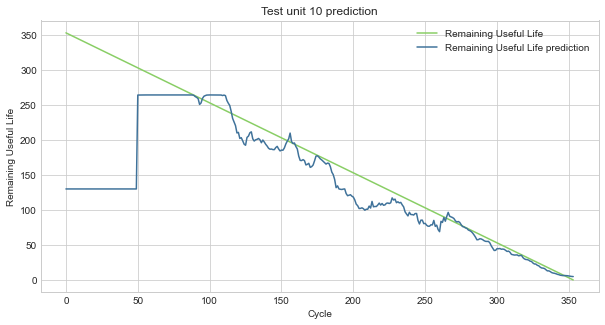

In [18]:
unit = 10

plt.style.use('seaborn-whitegrid')
fig = plt.figure(figsize = (10,5))

ax = fig.add_subplot(111)

ax.plot(range(len(train_df[train_df['Unit']==unit])), train_df[train_df['Unit']==unit]['RUL'], color = "#89ce65", label = "Remaining Useful Life")
#ax.plot(range(len(train_df[train_df['Unit']==unit])), Y_tuned[train_df.loc[train_df['Unit']==unit,:].index], color ="#89ce65", label = "Remaining Useful Life with limitation", linestyle = '--')
ax.plot(range(len(train_df[train_df['Unit']==unit])), train_df[train_df['Unit']==unit]['RUL_predict'], color ="#3f729a", label = "Remaining Useful Life prediction")


ax.set_ylabel("Remaining Useful Life")
ax.set_xlabel("Cycle")
ax.set_title("Test unit 10 prediction")

ax.legend()


In [19]:
test_proof = pd.DataFrame([test_df[test_df['Unit']==id].iloc[-1,:]
                for id in test_df['Unit'].unique()]).reset_index(drop = True)

error_df = pd.DataFrame()
error_df[['Unit','Cycle','RUL']] = test_proof[['Unit','Cycle','RUL']]
error_df['error'] =  np.abs(y_pred_test - y_true_test)

error_df['Group'] = 0
error_df.loc[error_df['Cycle'] <= 20, 'Group'] = 1
error_df.loc[(error_df['Cycle'] <= 40) & (error_df['Cycle'] > 20) , 'Group'] = 2
error_df.loc[(error_df['Cycle'] <= 60) & (error_df['Cycle'] > 40) , 'Group'] = 3
error_df.loc[(error_df['Cycle'] <= 80) & (error_df['Cycle'] > 60) , 'Group'] = 4
error_df.loc[(error_df['Cycle'] <= 100) & (error_df['Cycle'] > 80) , 'Group'] = 5
error_df.loc[(error_df['Cycle'] <= 120) & (error_df['Cycle'] > 100) , 'Group'] = 6
error_df.loc[(error_df['Cycle'] <= 140) & (error_df['Cycle'] > 120) , 'Group'] = 7
error_df.loc[(error_df['Cycle'] > 140) , 'Group'] = 8

error_df['Group_RUL'] = 0
error_df.loc[error_df['RUL'] <= 20, 'Group_RUL'] = 1
error_df.loc[(error_df['RUL'] <= 40) & (error_df['RUL'] > 20) , 'Group_RUL'] = 2
error_df.loc[(error_df['RUL'] <= 60) & (error_df['RUL'] > 40) , 'Group_RUL'] = 3
error_df.loc[(error_df['RUL'] <= 80) & (error_df['RUL'] > 60) , 'Group_RUL'] = 4
error_df.loc[(error_df['RUL'] <= 100) & (error_df['RUL'] > 80) , 'Group_RUL'] = 5
error_df.loc[(error_df['RUL'] <= 120) & (error_df['RUL'] > 100) , 'Group_RUL'] = 6
error_df.loc[(error_df['RUL'] <= 140) & (error_df['RUL'] > 120) , 'Group_RUL'] = 7
error_df.loc[(error_df['RUL'] > 140) , 'Group_RUL'] = 8

In [20]:
error_grouped  = error_df.groupby('Group').mean()

error_grouped_RUL = error_df.groupby('Group_RUL').mean()

error_grouped

,Unit,Cycle,RUL,error,Group_RUL
Group,,,,,
3,128.925926,52.185185,146.296296,104.259514,7.333333
4,162.133333,68.133333,127.133333,36.632317,6.666667
5,125.611111,90.500000,128.500000,38.367531,6.500000
6,122.653846,110.961538,99.461538,30.116854,5.269231
7,133.000000,129.565217,77.304348,28.638046,4.130435
8,118.374101,227.935252,64.251799,20.574873,3.618705


In [21]:
error_grouped_RUL

,Unit,Cycle,RUL,error,Group
Group_RUL,,,,,
1,128.350000,194.850000,11.650000,5.571950,7.800000
2,116.724138,235.172414,30.241379,14.777091,7.862069
3,122.909091,206.181818,50.500000,19.525642,7.409091
4,111.727273,171.227273,72.181818,20.918903,7.318182
5,125.085714,167.028571,90.742857,32.297226,6.571429
6,137.103448,160.034483,111.137931,35.895378,6.655172
7,116.842105,125.421053,129.631579,64.727646,5.421053
8,127.326923,111.942308,164.634615,65.660385,5.192308


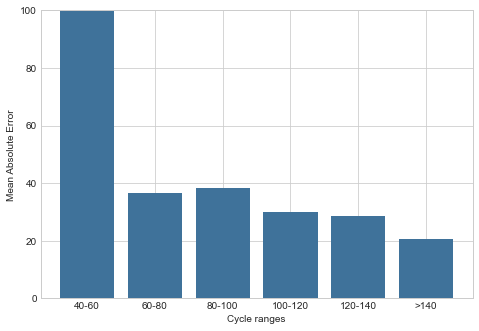

In [22]:
fig = plt.figure()

ax = fig.add_axes([0,0,1,1])
ratios = ['40-60', '60-80', '80-100', '100-120','120-140', '>140']
errors = error_grouped['error']
ax.bar(ratios,errors,color="#3f729a")
plt.ylabel("Mean Absolute Error")
plt.xlabel("Cycle ranges")
plt.ylim(0,100)
plt.show()

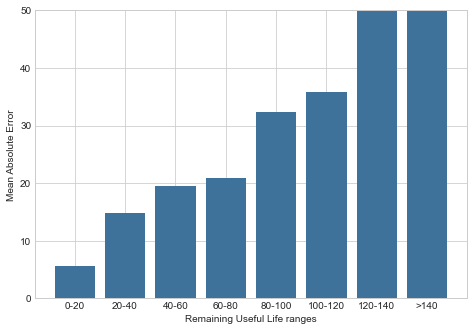

In [23]:
fig = plt.figure()

ax = fig.add_axes([0,0,1,1])
ratios = ['0-20','20-40', '40-60', '60-80', '80-100', '100-120','120-140', '>140']
errors = error_grouped_RUL['error']
ax.bar(ratios,errors,color="#3f729a")
plt.ylabel("Mean Absolute Error")
plt.xlabel("Remaining Useful Life ranges")
plt.ylim(0,50)
plt.show()

In [24]:
seq_gen_testing = (list(gen_sequence(test_df[test_df['Unit']==id], sequence_length, sequence_cols)) 
           for id in test_df['Unit'].unique())

seq_array_testing = np.concatenate(list(seq_gen_testing)).astype(np.float32)

seq_array_testing.shape

(29208, 50, 15)

In [25]:
test_prediction = RNN_model.predict(seq_array_testing)
test_prediction.shape

(29208, 1)

In [26]:
test_df['RUL_predict'] = 0
indice_retransf = 0
for i in test_df['Unit'].unique():

    print(i)

    max_indice = (test_df.loc[test_df['Unit']==i,'Cycle'].max() + indice_retransf -50).astype(int)

    print(indice_retransf)
    print(max_indice)

    print(test_df.loc[(test_df['Unit']==i)&(test_df['Cycle']>50), 'RUL_predict'].shape)
    print(test_prediction[indice_retransf:max_indice,0].shape)


    test_df.loc[(test_df['Unit']==i)&(test_df['Cycle']>50), 'RUL_predict'] = test_prediction[indice_retransf:max_indice,0]

    indice_retransf += (test_df.loc[test_df['Unit']==i,'Cycle'].max() - 50).astype(int)

1.0
0
180
(180,)
(180,)
2.0
180
283
(103,)
(103,)
3.0
283
374
(91,)
(91,)
4.0
374
532
(158,)
(158,)
5.0
532
533
(1,)
(1,)
6.0
533
629
(96,)
(96,)
7.0
629
633
(4,)
(4,)
8.0
633
831
(198,)
(198,)
9.0
831
1065
(234,)
(234,)
10.0
1065
1066
(1,)
(1,)
11.0
1066
1098
(32,)
(32,)
12.0
1098
1318
(220,)
(220,)
13.0
1318
1495
(177,)
(177,)
14.0
1495
1547
(52,)
(52,)
15.0
1547
1665
(118,)
(118,)
16.0
1665
1855
(190,)
(190,)
17.0
1855
2139
(284,)
(284,)
18.0
2139
2336
(197,)
(197,)
19.0
2336
2337
(1,)
(1,)
20.0
2337
2402
(65,)
(65,)
21.0
2402
2554
(152,)
(152,)
22.0
2554
2662
(108,)
(108,)
23.0
2662
2774
(112,)
(112,)
24.0
2774
2898
(124,)
(124,)
25.0
2898
3334
(436,)
(436,)
26.0
3334
3374
(40,)
(40,)
27.0
3374
3468
(94,)
(94,)
28.0
3468
3469
(1,)
(1,)
29.0
3469
3635
(166,)
(166,)
30.0
3635
3814
(179,)
(179,)
31.0
3814
3898
(84,)
(84,)
32.0
3898
4108
(210,)
(210,)
33.0
4108
4165
(57,)
(57,)
34.0
4165
4476
(311,)
(311,)
35.0
4476
4704
(228,)
(228,)
36.0
4704
4813
(109,)
(109,)
37.0
4813
5108
(295,)


In [27]:
test_prediction.shape

(29208, 1)

In [28]:
test_df[test_df['Unit']==83][['RUL','RUL_predict']]

,RUL,RUL_predict
14690,445.0,0.000000
14691,444.0,0.000000
14692,443.0,0.000000
14693,442.0,0.000000
14694,441.0,0.000000
...,...,...
14959,176.0,145.165863
14960,175.0,145.431595
14961,174.0,146.312622
14962,173.0,147.430176


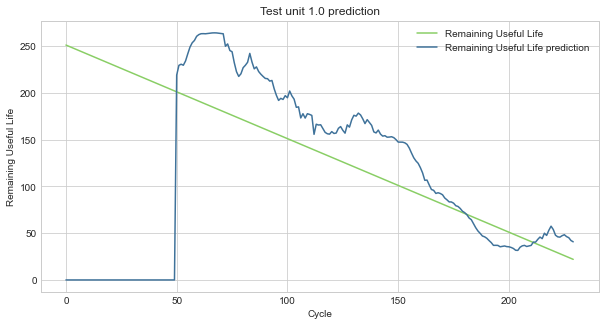

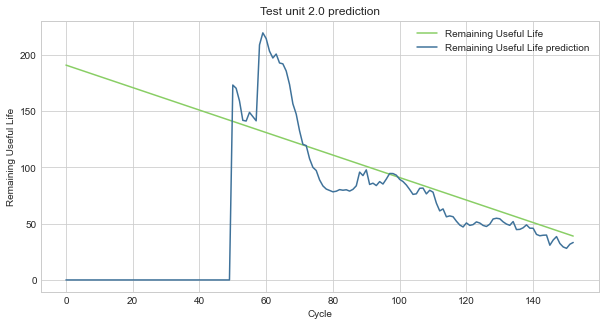

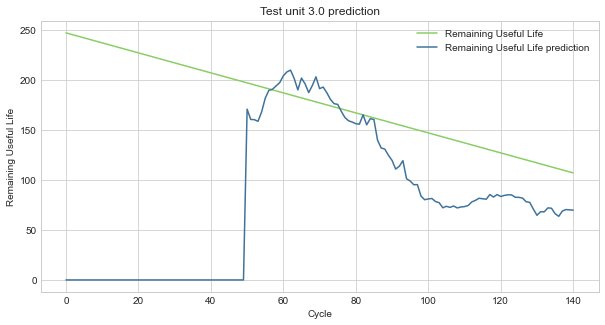

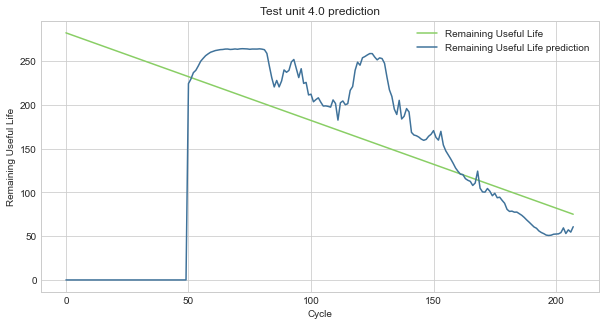

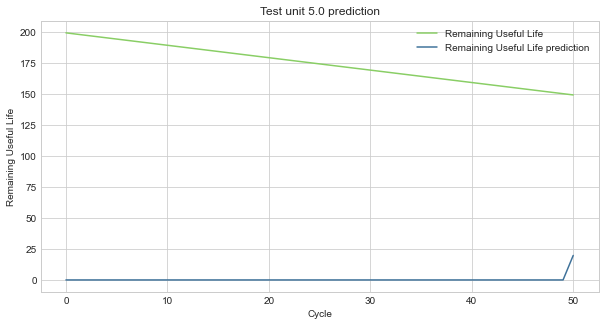

...

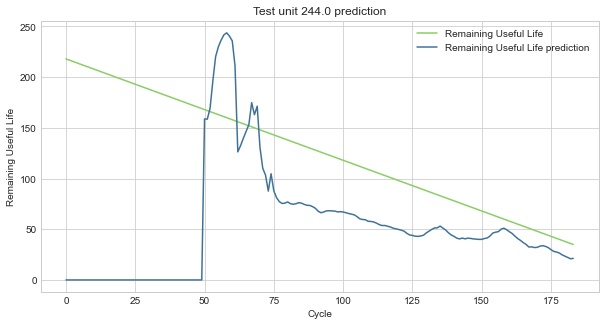

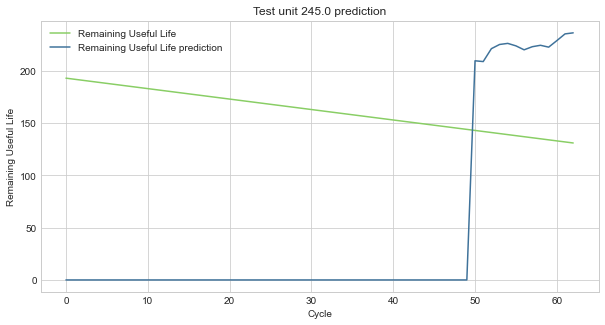

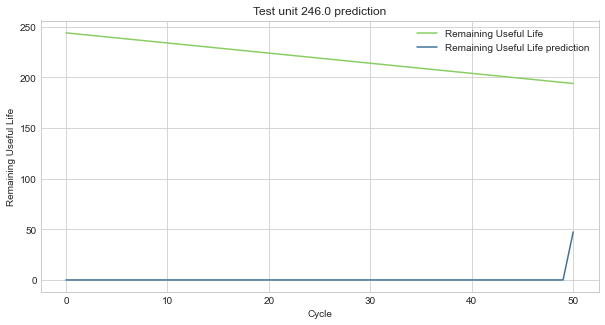

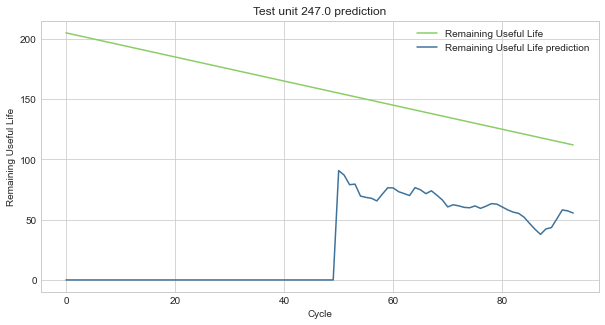

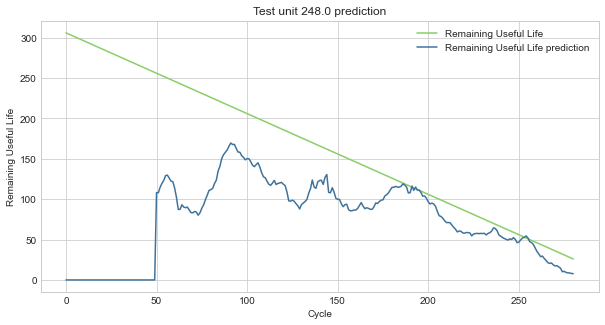

In [30]:
unit = 83

for unit in test_df['Unit'].unique():
    plt.style.use('seaborn-whitegrid')
    fig = plt.figure(figsize = (10,5))

    ax = fig.add_subplot(111)

    ax.plot(range(len(test_df[test_df['Unit']==unit])), test_df[test_df['Unit']==unit]['RUL'], color = "#89ce65", label = "Remaining Useful Life")
    #ax.plot(range(len(train_df[train_df['Unit']==unit])), Y_tuned[train_df.loc[train_df['Unit']==unit,:].index], color ="#89ce65", label = "Remaining Useful Life with limitation", linestyle = '--')
    ax.plot(range(len(test_df[test_df['Unit']==unit])), test_df[test_df['Unit']==unit]['RUL_predict'], color ="#3f729a", label = "Remaining Useful Life prediction")


    ax.set_ylabel("Remaining Useful Life")
    ax.set_xlabel("Cycle")
    ax.set_title("Test unit {} prediction".format(unit))

    ax.legend()
